In [26]:
# Standard Imports
from __future__ import print_function
import numpy as np
import pandas as pd
import os
import sys
from collections import defaultdict
from importlib import reload
from bs4 import BeautifulSoup
import requests
import scipy.stats as scs

import matplotlib.pyplot as plt
%matplotlib inline
%config InlineBackend.figure_format = 'retina'


# Load MongoDB
from pymongo import MongoClient
client = MongoClient()
# Access/Initiate Database
db = client['producer_db']
# Access/Initiate Table
tab = db['songs']
collection = db.tab

# Authorize Spotify API
import spotipy
from spotipy.oauth2 import SpotifyClientCredentials
client_id = os.environ['SPOTIFY_CLIENT_ID']
client_secret = os.environ['SPOTIFY_CLIENT_SECRET']
client_credentials_manager = SpotifyClientCredentials(client_id=client_id, client_secret=client_secret)
sp = spotipy.Spotify(client_credentials_manager=client_credentials_manager)

# Audio Processing
import librosa
from IPython.display import Audio
from scipy.io import wavfile
from pydub import AudioSegment


In [27]:
example_mp3_url = 'https://p.scdn.co/mp3-preview/22bf10aff02db272f0a053dff5c0063d729df988?cid=5157426229ce47aea8e1a6c56e231ddf'
r = requests.get(example_mp3_url)

In [90]:
import soundfile as sf
import io

from six.moves.urllib.request import urlopen

url = "https://raw.githubusercontent.com/librosa/librosa/master/tests/data/test1_44100.wav"

data, samplerate = sf.read(io.BytesIO(urlopen(url).read()))



In [91]:
import numpy as np

rate = 44100
data = np.random.randn(2 * rate)

librosa.output.write_wav('file.wav', data, rate)

In [97]:
! pwd

/Users/Maxwell/galvanize/production-value


In [102]:
Audio(url = example_mp3_url+'.mp3')

In [28]:
Audio(r.content)

In [35]:
# Beat tracking example
from __future__ import print_function
import librosa

# 1. Get the file path to the included audio example
filename = librosa.util.example_audio_file()

In [36]:
filename

'/Users/Maxwell/anaconda3/lib/python3.7/site-packages/librosa/util/example_data/Kevin_MacLeod_-_Vibe_Ace.ogg'

In [38]:
! ffmpeg -i /Users/Maxwell/anaconda3/lib/python3.7/site-packages/librosa/util/example_data/Kevin_MacLeod_-_Vibe_Ace.ogg ./audio.wav

ffmpeg version 4.1.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with Apple LLVM version 10.0.0 (clang-1000.11.45.5)
  configuration: --prefix=/usr/local/Cellar/ffmpeg/4.1.2 --enable-shared --enable-pthreads --enable-version3 --enable-hardcoded-tables --enable-avresample --cc=clang --host-cflags='-I/Library/Java/JavaVirtualMachines/openjdk-11.0.2.jdk/Contents/Home/include -I/Library/Java/JavaVirtualMachines/openjdk-11.0.2.jdk/Contents/Home/include/darwin' --host-ldflags= --enable-ffplay --enable-gnutls --enable-gpl --enable-libaom --enable-libbluray --enable-libmp3lame --enable-libopus --enable-librubberband --enable-libsnappy --enable-libtesseract --enable-libtheora --enable-libvorbis --enable-libvpx --enable-libx264 --enable-libx265 --enable-libxvid --enable-lzma --enable-libfontconfig --enable-libfreetype --enable-frei0r --enable-libass --enable-libopencore-amrnb --enable-libopencore-amrwb --enable-libopenjpeg --enable-librtmp --enable-libspeex --enable-videotoolbox --disa

In [39]:
# 2. Load the audio as a waveform `y`
#    Store the sampling rate as `sr`
y, sr = librosa.load('audio.wav')

# 3. Run the default beat tracker
tempo, beat_frames = librosa.beat.beat_track(y=y, sr=sr)

print('Estimated tempo: {:.2f} beats per minute'.format(tempo))

# 4. Convert the frame indices of beat events into timestamps
beat_times = librosa.frames_to_time(beat_frames, sr=sr)

print('Saving output to beat_times.csv')
librosa.output.times_csv('beat_times.csv', beat_times)

Estimated tempo: 129.20 beats per minute
Saving output to beat_times.csv


/Users/Maxwell/anaconda3/lib/python3.7/site-packages/scipy/fftpack/basic.py:160: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  z[index] = x


In [40]:
Audio('audio.wav')

(0, 100000)

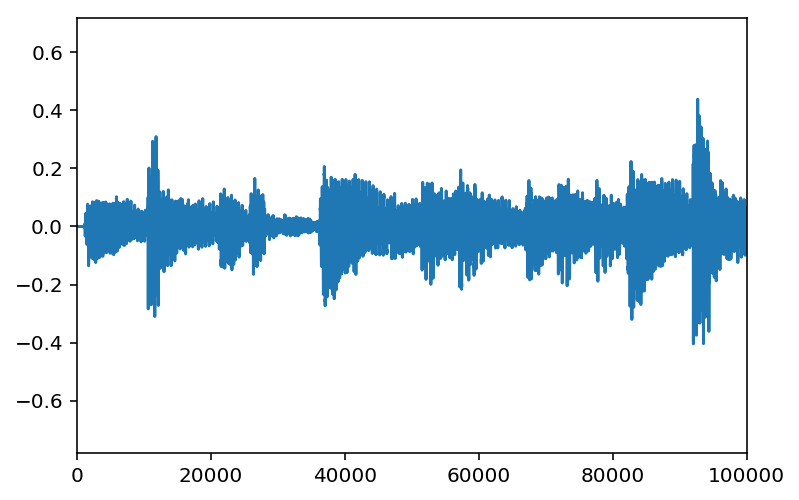

In [45]:
plt.plot(y)
plt.xlim((0,100000))

In [46]:
# Feature extraction example
import numpy as np
import librosa

# Load the example clip
y, sr = librosa.load('audio.wav')

# Set the hop length; at 22050 Hz, 512 samples ~= 23ms
hop_length = 512

# Separate harmonics and percussives into two waveforms
y_harmonic, y_percussive = librosa.effects.hpss(y)

# Beat track on the percussive signal
tempo, beat_frames = librosa.beat.beat_track(y=y_percussive,
                                             sr=sr)

# Compute MFCC features from the raw signal
mfcc = librosa.feature.mfcc(y=y, sr=sr, hop_length=hop_length, n_mfcc=13)

# And the first-order differences (delta features)
mfcc_delta = librosa.feature.delta(mfcc)

# Stack and synchronize between beat events
# This time, we'll use the mean value (default) instead of median
beat_mfcc_delta = librosa.util.sync(np.vstack([mfcc, mfcc_delta]),
                                    beat_frames)

# Compute chroma features from the harmonic signal
chromagram = librosa.feature.chroma_cqt(y=y_harmonic,
                                        sr=sr)

# Aggregate chroma features between beat events
# We'll use the median value of each feature between beat frames
beat_chroma = librosa.util.sync(chromagram,
                                beat_frames,
                                aggregate=np.median)

# Finally, stack all beat-synchronous features together
beat_features = np.vstack([beat_chroma, beat_mfcc_delta])

/Users/Maxwell/anaconda3/lib/python3.7/site-packages/scipy/fftpack/basic.py:160: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  z[index] = x
/Users/Maxwell/anaconda3/lib/python3.7/site-packages/scipy/signal/_arraytools.py:45: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  b = a[a_slice]


In [50]:
Audio(data = y_harmonic, rate = sr)

In [56]:
Audio(data = y_percussive, rate = sr)

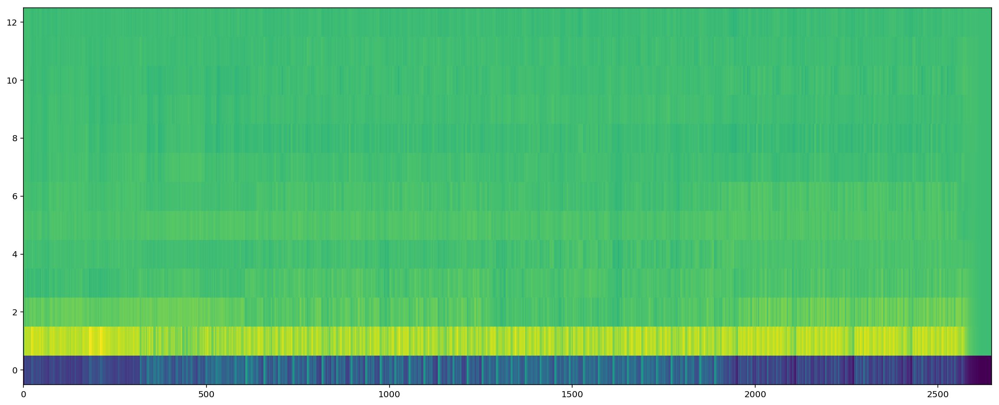

In [63]:
plt.figure(figsize=(20,8))
plt.imshow(mfcc, aspect='auto', origin = 'lower')

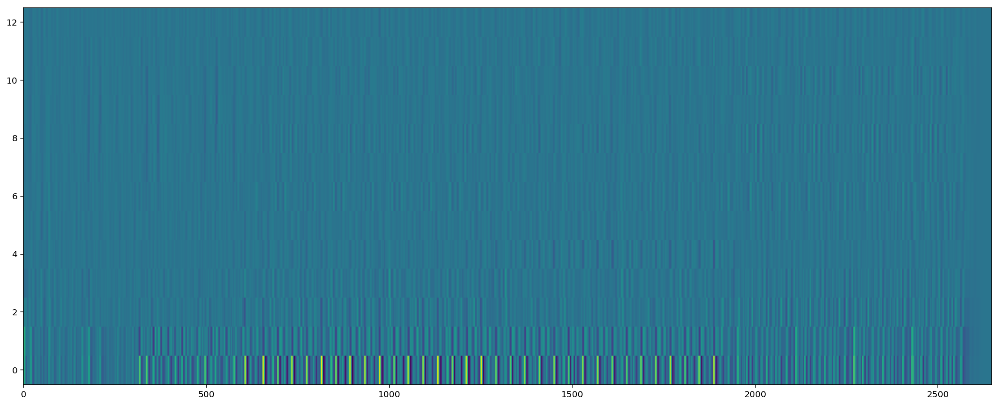

In [64]:
plt.figure(figsize=(20,8))
plt.imshow(mfcc_delta, aspect='auto', origin = 'lower')

Exception ignored in: <function Wave_write.__del__ at 0x1c21e2d730>
Traceback (most recent call last):
  File "/Users/Maxwell/anaconda3/lib/python3.7/wave.py", line 327, in __del__
    self.close()
  File "/Users/Maxwell/anaconda3/lib/python3.7/wave.py", line 445, in close
    self._ensure_header_written(0)
  File "/Users/Maxwell/anaconda3/lib/python3.7/wave.py", line 465, in _ensure_header_written
    raise Error('sample width not specified')
wave.Error: sample width not specified


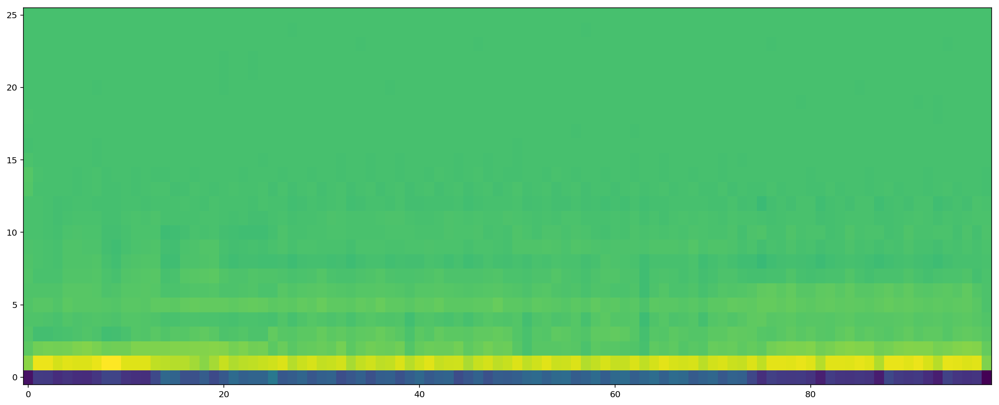

In [65]:
plt.figure(figsize=(20,8))
plt.imshow(beat_mfcc_delta, aspect='auto', origin = 'lower')

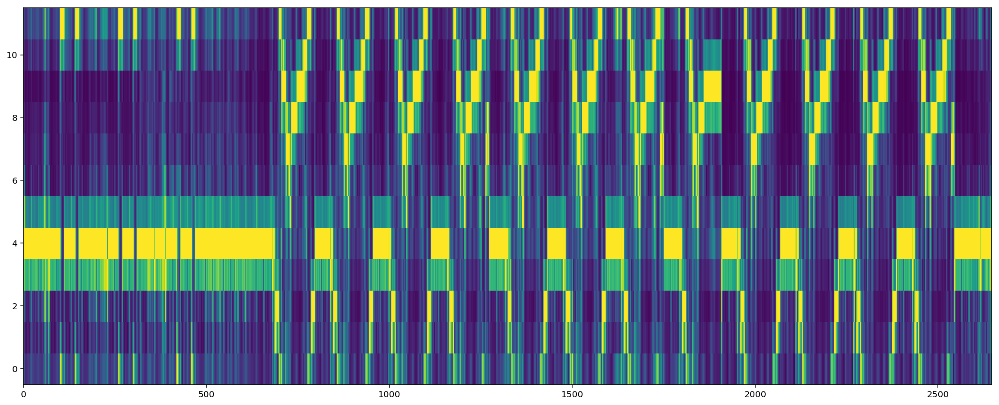

In [66]:
plt.figure(figsize=(20,8))
plt.imshow(chromagram, aspect='auto', origin = 'lower')

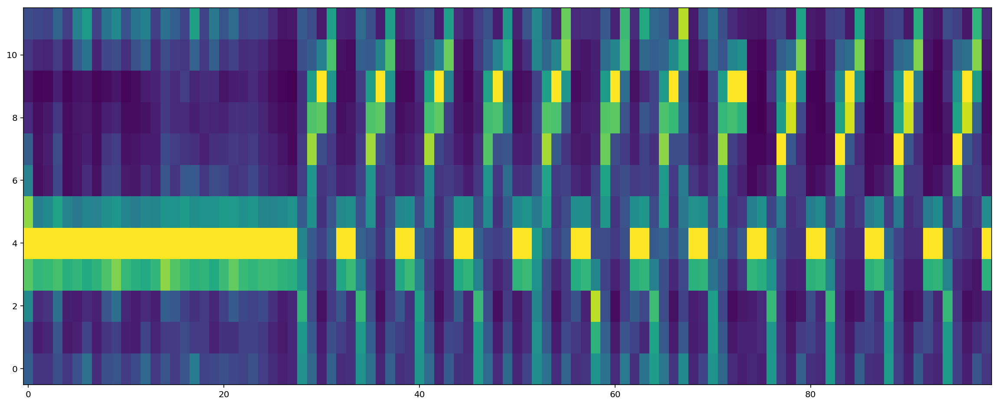

In [67]:
plt.figure(figsize=(20,8))
plt.imshow(beat_chroma, aspect='auto', origin = 'lower')

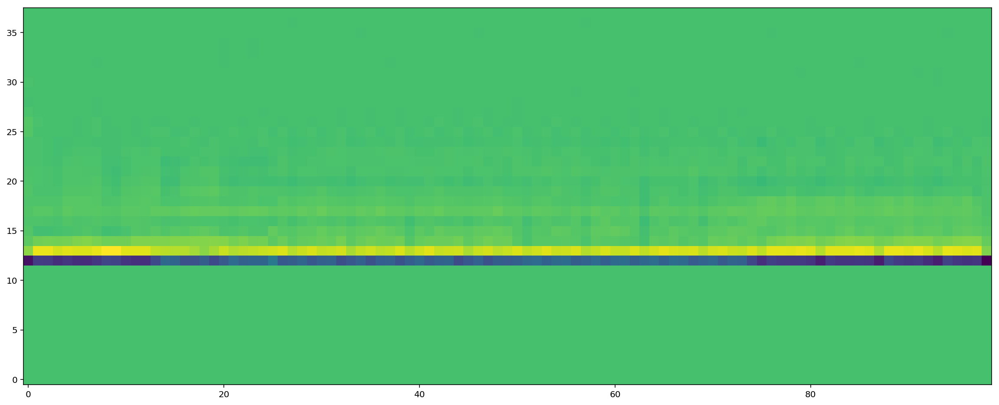

In [69]:
plt.figure(figsize=(20,8))
plt.imshow(beat_features, aspect='auto', origin = 'lower')

In [103]:
# How to load an mp3 into librosa

Audio(url = example_mp3_url+'.mp3')

In [106]:
import urllib.request
urllib.request.urlretrieve(example_mp3_url, "mp3.mp3")

('mp3.mp3', <http.client.HTTPMessage at 0x1c33f5c3c8>)

In [107]:
Audio('mp3.mp3')

In [108]:
from os import path
from pydub import AudioSegment

# files                                                                         
src = "mp3.mp3"
dst = "wav.wav"

# convert wav to mp3                                                            
sound = AudioSegment.from_mp3(src)
sound.export(dst, format="wav")

<_io.BufferedRandom name='wav.wav'>

In [109]:
Audio('wav.wav')

In [114]:
import urllib.request
from os import path
from pydub import AudioSegment

# retrieve audio
mp3_url = example_mp3_url
urllib.request.urlretrieve(mp3_url, "temp.mp3")

# files                                                                         
src = "temp.mp3"
dst = "temp.wav"

# convert mp3 to wav                                                            
sound = AudioSegment.from_mp3(src)
sound.export(dst, format="wav")

y, sr = librosa.load("temp.wav")

In [117]:
Audio(y, rate = sr)

In [123]:
def load_mp3_from_url(mp3_url, mp3_path = "temp.mp3", wav_path = "wav.mp3"):
    
    # retreive audio from url and save
    urllib.request.urlretrieve(mp3_url, mp3_path)

    # files                                                                         
    src = mp3_path
    dst = wav_path

    # convert mp3 to wav                                                            
    sound = AudioSegment.from_mp3(src)
    sound.export(dst, format="wav")

    y, sr = librosa.load(wav_path)
    
    return y, sr

In [122]:
y, sr = load_mp3_from_url('https://p.scdn.co/mp3-preview/e7ea8a13f7caf6942c5447e9cd96aac2a076d85a?cid=5157426229ce47aea8e1a6c56e231ddf')

FileNotFoundError: [Errno 2] No such file or directory: 'temp/temp.mp3'

In [120]:
Audio(y, rate = sr)